(C) Gerold Baier, University College London, 2025

# Model of N Coupled E-I Oscillators in two spatial Dimension


## Import

In [8]:
from scipy.integrate import odeint
from scipy.signal import find_peaks, butter, sosfilt
from scipy.fft import rfft, rfftfreq, irfft

from numpy import zeros, ones, tanh, mod, gradient, linspace, sign, log, meshgrid, sort, pi, exp, array, around, arange
from numpy import sqrt, fill_diagonal, ndarray, amax, amin, where, c_, histogram, complex128, flip, ravel_multi_index, unravel_index

from numpy.random import uniform, default_rng, normal, seed, randn, rand

from matplotlib.pyplot import subplots

import sk_dsp_comm.sigsys as ss

from models import N_oscillators


## Model and Functions

## The N-variable neural population oscillator

The two populations' temporal dynamics with inhibitory internal coupling is described by two first-order nonlinear differential equations:

equation incorrect
$$ \frac{dEx}{dt}      = (h_{ex}      - Ex    - c_2*sigmoid(In) + c_{EE}*\sum_{n=1}^{N} *sigmoid(Ex_n))*\tau_{ex} + pert$$
$$ \frac{dIn}{dt} \,\, = (h_{in} \,\, - In \, - c_4*sigmoid(In) + c_{EI}*\sum_{n=1}^{N} *sigmoid(Ex_n))*\tau_{in} $$
equation incorrect

$Ex$ and $In$ are time-dependant variables representing the excitatory and inhibitory neural population, respectively.

$h_{ex}$ and $h_{in}$ are model parameters representing constant (external) input to the excitatory and inhibitory population, respectively.

$c_2$ and $c_4$ are parameters that control the internal inhibition of the two populations.

$c_{EE}$ and $c_{EI}$ are the coupling constants of the excitatory coupling matrices. 

$\tau_{ex}$ and $\tau_{in}$ are the poulation time constants.

_pert_ represents an additive external perturbation.

Function _sigmoid_ is the continuous step function, conmputationally implemented as tangens hyperbolicus.

In [2]:

# def sigmoid(u):
#     return tanh(u)
    
# def N_oscillators(y, t, N, h_ex_rand, h_in_rand, 
#                         coupling_matrix_EE, coupling_matrix_EI, cconst_E, cconst_I, pars, sr, time_stop, pert, pert_osc):
        
#     tau_ex, tau_in, c2, c4 = pars
    
#     time_index = int(t*sr)
    
#     if time_index >= time_stop*sr:

#         dydt = zeros(2*N)
        
#         return dydt

#     # Separate Variables
#     y_ex = y[:-1:2]
#     y_in = y[1::2]

#     dy_ex, dy_in = zeros(N), zeros(N)
#     dydt = zeros(2*N)

#     for osc in arange(N):

#         coup_EE = cconst_E*sigmoid(sum(coupling_matrix_EE[:, osc] * y_ex))
#         coup_EI = cconst_I*sigmoid(sum(coupling_matrix_EI[:, osc] * y_ex))

#         if osc == pert_osc:
                
#             dy_ex[osc] = (pert[time_index] - y_ex[osc] - c2*sigmoid(y_in[osc]) + coup_EE)*tau_ex 
#             dy_in[osc] = (h_in_rand[osc]   - y_in[osc] - c4*sigmoid(y_in[osc]) + coup_EI)*tau_in

#         else:
                
#             dy_ex[osc] = (h_ex_rand[osc]   - y_ex[osc] - c2*sigmoid(y_in[osc]) + coup_EE)*tau_ex 
#             dy_in[osc] = (h_in_rand[osc]   - y_in[osc] - c4*sigmoid(y_in[osc]) + coup_EI)*tau_in


#     # Combine Variables
#     dydt[:-1:2] = dy_ex
#     dydt[1: :2] = dy_in

#     return dydt

# def create_sparse_coupling_matrix(N):
#     """
#     Create a sparse coupling matrix for better memory efficiency.
#     """
#     from scipy import sparse

#     rows, cols = int(N**(1/2)), int(N**(1/2))

#     n = rows * cols
#     row_indices = []
#     col_indices = []
    
#     for i in range(rows):
#         for j in range(cols):
#             current_idx = i * cols + j
            
#             # Right neighbor
#             if j < cols - 1:
#                 right_idx = i * cols + (j + 1)
#                 row_indices.extend([current_idx, right_idx])
#                 col_indices.extend([right_idx, current_idx])
            
#             # Bottom neighbor
#             if i < rows - 1:
#                 bottom_idx = (i + 1) * cols + j
#                 row_indices.extend([current_idx, bottom_idx])
#                 col_indices.extend([bottom_idx, current_idx])
    
#     # Create sparse matrix
#     data = ones(len(row_indices), dtype=int)
#     coupling_matrix = sparse.csr_matrix((data, (row_indices, col_indices)), shape=(n, n))
    
#     return coupling_matrix.toarray()  # Convert to dense for visualization

# # Number of oscillators
# N = 25 # uneven square number

# rows, cols = int(N**(1/2)), int(N**(1/2))

# h_ex_0 = -7.15
# h_in_0 = -4.0

# eps          = 0.00
# RANDOM_STATE = 1111
# seed(RANDOM_STATE)
# random_vals        = eps*normal(0,1,size=N)
# random_vals_sorted = sort(random_vals)
# h_ex_rand = h_ex_0 - random_vals_sorted
# h_in_rand = h_in_0 - eps*normal(0,1,size=N)

# h_centre_index = ravel_multi_index(((rows-1)//2, (cols-1)//2), (rows, cols))

# # Parameters
# pars = (1, 2.5, 10, 0) 

# coupling_strength_EE, coupling_strength_EI = 5., 10.

# frac_EE, frac_EI = 0.01, 0.0

# # Coupling
# coupling_matrix_EE_ini = create_sparse_coupling_matrix(N)
# coupling_matrix_EI_ini = coupling_matrix_EE_ini.copy()

# coupling_matrix_EE = coupling_matrix_EE_ini*frac_EE
# coupling_matrix_EI = coupling_matrix_EI_ini*frac_EI

# fill_diagonal(coupling_matrix_EE, 1)
# fill_diagonal(coupling_matrix_EI, 1)

# # Time array
# time_stop = 50
# sr        = 1000
# samples   = time_stop*sr
# time      = linspace(start=0, stop=time_stop, num=samples)

# freq      = 0.1
# pulse_wid = 4
# pulse_amp = 1.0

# # Initial conditions:
# seed(88123)
# y_ini = normal(size=2*N)


# pert      = h_ex_0 + pulse_amp*ss.rect(mod(time, 1/freq)-(1/freq)/2+pulse_wid/2, pulse_wid)

# pert_osc  = h_centre_index

# y_pert    = odeint(func=N_oscillators, y0=y_ini, t=time, 
#                 args=(N, h_ex_rand, h_in_rand,  
#                     coupling_matrix_EE,   coupling_matrix_EI, 
#                     coupling_strength_EE, coupling_strength_EI,
#                     pars, sr, time_stop, pert, pert_osc), 
#                 hmax=0.2)

# print('Complete')
    
# def N_oscillators(y, t, N, h_ex_rand, h_in_rand, 
#                         coupling_matrix_EE, coupling_matrix_EI, cconst_E, cconst_I, pars, sr, time_stop, pert, pert_osc):
        
#     tau_ex, tau_in, c2, c4 = pars
    
#     time_index = int(t*sr)
    
#     if time_index >= time_stop*sr:

#         dydt = zeros(2*N)
        
#         return dydt

#     # Separate Variables
#     y_ex = y[:-1:2]
#     y_in = y[1::2]

#     dy_ex, dy_in = zeros(N), zeros(N)
#     dydt = zeros(2*N)

#     for osc in arange(N):

#         coup_EE = cconst_E*sigmoid(sum(coupling_matrix_EE[:, osc] * y_ex))
#         coup_EI = cconst_I*sigmoid(sum(coupling_matrix_EI[:, osc] * y_ex))

#         if osc == pert_osc:
                
#             dy_ex[osc] = (pert[time_index] - y_ex[osc] - c2*sigmoid(y_in[osc]) + coup_EE)*tau_ex 
#             dy_in[osc] = (h_in_rand[osc]   - y_in[osc] - c4*sigmoid(y_in[osc]) + coup_EI)*tau_in

#         else:
                
#             dy_ex[osc] = (h_ex_rand[osc]   - y_ex[osc] - c2*sigmoid(y_in[osc]) + coup_EE)*tau_ex 
#             dy_in[osc] = (h_in_rand[osc]   - y_in[osc] - c4*sigmoid(y_in[osc]) + coup_EI)*tau_in


#     # Combine Variables
#     dydt[:-1:2] = dy_ex
#     dydt[1: :2] = dy_in

#     return dydt


In [6]:
def plot_series(time, data, time_begin, time_end, sr):
    
    N = data.shape[1]//2
    
    name_vars = ('Ex_', 'In_')

    no_vars = len(name_vars)

    if N == 1:

        fig, ax = subplots(ncols=len(name_vars), figsize=(8, 6))

        for ind in arange(no_vars):

            ax[ind].plot(time[time_begin*sr:time_end*sr], data[time_begin*sr:time_end*sr, ind], linewidth=2, c='b')
            ax[ind].set_xticks(linspace(0, (time_end-time_begin)*sr, 5));
            ax[ind].set_xticklabels([]);
            ax[ind].set_xlabel('Time', fontsize=14);
            ax[ind].set_ylabel(name_vars[ind], fontsize=14)
            y_min, y_max = ax[ind].get_ylim()
            ax[ind].set_yticks(linspace(y_min, y_max, 3));
            ax[ind].set_yticklabels(around(linspace(y_min, y_max, 3),1), fontsize=14);

    else:

        y_max1 = amax(data[:, arange(0, 2*N, 2)])

        if y_max1 > 0:

            y_max1_ax = 1.1*y_max1

        else:

            y_max1_ax = 0.9*y_max1


        y_min1 = amin(data[:, arange(0, 2*N, 2)])

        if y_min1 > 0:

            y_min1_ax = 0.9*y_min1

        else:

            y_min1_ax = 1.1*y_min1


        y_max2 = amax(data[:, arange(1, 2*N+1, 2)])

        if y_mx2 > 0:

            y_max2_ax = 1.1*y_max2

        else:

            y_max2_ax = 0.9*y_max2   


        y_min2 = amin(data[:, arange(1, 2*N+1, 2)])

        if y_min2 > 0:

            y_min2_ax = 0.9*y_min2

        else:

            y_min2_ax = 1.1*y_min2


        fig, ax = subplots(ncols=len(name_vars), nrows=N, figsize=(10, 6))

        for osc in arange(N):
            for ind in arange(2):

                if ind == 0:
                    ax[osc, ind].plot(time[time_begin*sr:time_end*sr], data[time_begin*sr:time_end*sr, 2*osc+ind], linewidth=1, c='b')
                    ax[osc, ind].set_xticklabels([]);
                    ax[osc, ind].set_ylim(y_min1_ax, y_max1_ax)   
                    ax[osc, ind].set_yticks(linspace(y_min1_ax, y_max1_ax, 3));
                    ax[osc, ind].set_yticklabels(around(linspace(y_min1_ax, y_max1_ax, 3),1), fontsize=14);

                elif ind == 1:
                    ax[osc, ind].plot(time[time_begin*sr:time_end*sr], data[time_begin*sr:time_end*sr, 2*osc+ind], linewidth=1, c='r')
                    
                    ax[osc, ind].set_xticklabels([]);
                    ax[osc, ind].set_ylim(y_min2_ax, y_max2_ax)
                    ax[osc, ind].set_yticks(linspace(y_min2_ax, y_max2_ax, 3));
                    ax[osc, ind].set_yticklabels(around(linspace(y_min2_ax, y_max2_ax, 3),1), fontsize=14);

                if osc == N-1:

                    ax[N-1, ind].set_xlabel('Time', fontsize=14);
                    # print(time[time_begin*sr:time_end*sr].size)
                    # print((time_end-time_begin)*sr)
                    ax[N-1, ind].set_xticks(linspace(time_begin, time_end, 5));
                    ax[N-1, ind].set_xticklabels(linspace(time_begin, time_end, 5));

                label_text = name_vars[ind] + str(osc+1)

                ax[osc, ind].set_ylabel(label_text, fontsize=14)

    fig.tight_layout()
    
    return fig, ax




## Time Series with Periodic Perturbation

In [7]:
def create_sparse_coupling_matrix(N):
    """
    Create a sparse coupling matrix for better memory efficiency.
    """
    from scipy import sparse

    rows, cols = int(N**(1/2)), int(N**(1/2))

    n = rows * cols
    row_indices = []
    col_indices = []
    
    for i in range(rows):
        for j in range(cols):
            current_idx = i * cols + j
            
            # Right neighbor
            if j < cols - 1:
                right_idx = i * cols + (j + 1)
                row_indices.extend([current_idx, right_idx])
                col_indices.extend([right_idx, current_idx])
            
            # Bottom neighbor
            if i < rows - 1:
                bottom_idx = (i + 1) * cols + j
                row_indices.extend([current_idx, bottom_idx])
                col_indices.extend([bottom_idx, current_idx])
    
    # Create sparse matrix
    data = ones(len(row_indices), dtype=int)
    coupling_matrix = sparse.csr_matrix((data, (row_indices, col_indices)), shape=(n, n))
    
    return coupling_matrix.toarray()  # Convert to dense for visualization


# Number of oscillators
N = 49

rows, cols = int(N**(1/2)), int(N**(1/2))

# Excitatory input parameter
h_ex_0 = -6.48
h_in_0 = -4.0

eps          = 0.00
RANDOM_STATE = 1111
seed(RANDOM_STATE)
random_vals        = eps*normal(0,1,size=N)
random_vals_sorted = sort(random_vals)
h_ex_rand = h_ex_0 - random_vals_sorted
h_in_rand = h_in_0 - eps*normal(0,1,size=N)

h_centre_index = ravel_multi_index(((rows-1)//2, (cols-1)//2), (rows, cols))

def get_cross_neighbors(center_idx, rows, cols):
    """Get center and 4 nearest neighbors in cross pattern (up, down, left, right)"""
    center_row, center_col = unravel_index(center_idx, (rows, cols))
    neighbors = [center_idx]
    
    # Up neighbor
    if center_row > 0:
        neighbors.append(ravel_multi_index((center_row - 1, center_col), (rows, cols)))
    
    # Down neighbor
    if center_row < rows - 1:
        neighbors.append(ravel_multi_index((center_row + 1, center_col), (rows, cols)))
    
    # Left neighbor
    if center_col > 0:
        neighbors.append(ravel_multi_index((center_row, center_col - 1), (rows, cols)))
    
    # Right neighbor
    if center_col < cols - 1:
        neighbors.append(ravel_multi_index((center_row, center_col + 1), (rows, cols)))
    
    return neighbors


# Parameters

pars = (1, 1.5, 10, 0)   # Homoclinic
# pars = (1, 1.5, 10, 0) # SNIC
# pars = (1, 1, 10, 0)   # Fast SNIC
# t_ex, t_in, c2, c4

coupling_strength_EE, coupling_strength_EI = 5., 10.

frac_EE, frac_EI = 0.2, 0.

# Coupling
coupling_matrix_EE_ini = create_sparse_coupling_matrix(N)
coupling_matrix_EI_ini = coupling_matrix_EE_ini.copy()

coupling_matrix_EE = coupling_matrix_EE_ini*frac_EE
coupling_matrix_EI = coupling_matrix_EI_ini*frac_EI

fill_diagonal(coupling_matrix_EE, 1)
fill_diagonal(coupling_matrix_EI, 1)


# Get the list of oscillators to perturb (center + 4 neighbors)
# pert_osc_list = get_cross_neighbors(h_centre_index, rows, cols)
pert_osc_list = [16, 17, 18, 23, 24, 25, 30, 31, 32]
print(f"Perturbing oscillators at indices: {pert_osc_list}")

# Time array and perturbation
time_stop = 60
sr        = 1000
samples   = time_stop*sr
time      = linspace(start=0, stop=time_stop, num=samples)

freq      = 0.12
pulse_wid = 3.7
pulse_amp = 3.0

# Initial conditions:
seed(883)
y_ini = normal(size=2*N)
# y_ini = y_pert[-1, :]


pert = h_ex_0 + pulse_amp*ss.rect(mod(time, 1/freq)-(1/freq)/2+pulse_wid/2, pulse_wid)

# Run simulation with list of perturbed oscillators
y_pert = odeint(func=N_oscillators, y0=y_ini, t=time, 
                args=(N, h_ex_rand, h_in_rand,  
                    coupling_matrix_EE,   coupling_matrix_EI, 
                    coupling_strength_EE, coupling_strength_EI,
                    pars, sr, time_stop, pert, pert_osc_list),  # Changed to list
                hmax=0.2)

print('Complete')


y_unfiltered = y_pert[:,::2]

start, stop = 0, y_pert.shape[0]

offset = 1

vmin, vmax = -3., -0

###################################################
fig, ax = subplots(nrows=1, ncols=2, figsize=(6, 6))

ax[0].plot(y_unfiltered[start:stop, :] + offset*arange(N-1,-1,-1), 
        linewidth=1, color='b');
# ax[0].set_yticks(offset*arange(N))
# ax[0].set_yticklabels(flip(arange(N))+1)
ax[0].margins(x=0)
ax[0].set_xticks(linspace(0, stop-start, 3))
labl = linspace(start/sr, stop/sr, 3)
ax[0].set_xticklabels(labl, fontsize=12)
ax[0].set_xlabel('Time', fontsize=12)


ax[1].imshow(y_unfiltered[start:stop, :].T, aspect='auto', 
          cmap='bwr_r', vmin=vmin, vmax=vmax);
ax[1].set_xticks(linspace(0, stop-start, 3))
labl = linspace(start/sr, stop/sr, 3)
ax[1].set_xticklabels(labl, fontsize=12)
ax[1].set_xlabel('Time', fontsize=12)
ax[1].set_yticks(arange(y_unfiltered.shape[1]));
ax[1].set_yticklabels(arange(y_unfiltered.shape[1])+1);

fig.tight_layout()


Perturbing oscillators at indices: [16, 17, 18, 23, 24, 25, 30, 31, 32]


NameError: name 'N_oscillators' is not defined

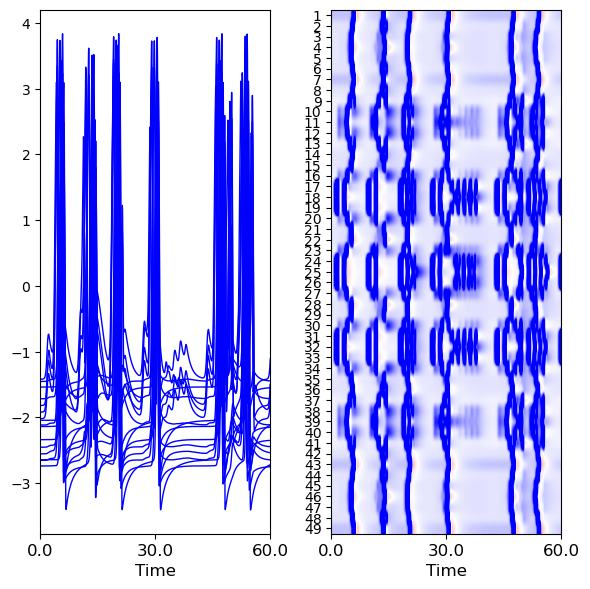

In [194]:
offset = 0.1

fig, ax = subplots(nrows=1, ncols=2, figsize=(6, 6))

ax[0].plot(y_unfiltered[start:stop, 33:] - offset*arange(49-33), 
        linewidth=1, color='b');
# ax[0].set_yticks(offset*arange(N))
# ax[0].set_yticklabels(flip(arange(N))+1)
ax[0].margins(x=0)
ax[0].set_xticks(linspace(0, stop-start, 3))
labl = linspace(start/sr, stop/sr, 3)
ax[0].set_xticklabels(labl, fontsize=12)
ax[0].set_xlabel('Time', fontsize=12)


ax[1].imshow(y_unfiltered[start:stop, :].T, aspect='auto', 
          cmap='bwr_r', vmin=vmin, vmax=vmax);
ax[1].set_xticks(linspace(0, stop-start, 3))
labl = linspace(start/sr, stop/sr, 3)
ax[1].set_xticklabels(labl, fontsize=12)
ax[1].set_xlabel('Time', fontsize=12)
ax[1].set_yticks(arange(y_unfiltered.shape[1]));
ax[1].set_yticklabels(arange(y_unfiltered.shape[1])+1);

fig.tight_layout()


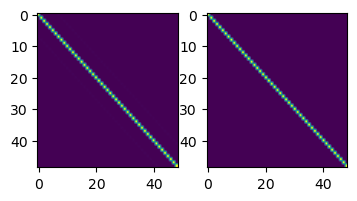

In [133]:
fig, ax = subplots(ncols=2, figsize=(4, 2))

ax[0].imshow(coupling_matrix_EE, aspect='auto');
ax[1].imshow(coupling_matrix_EI, aspect='auto');

In [134]:
pert_osc_list, h_centre_index

([np.int64(24), np.int64(17), np.int64(31), np.int64(23), np.int64(25)],
 np.int64(24))

In [195]:
data = y_unfiltered.reshape(time_stop*sr, rows, cols).transpose()

data.shape

(7, 7, 60000)

In [196]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
from IPython.display import HTML
import numpy as np

def animate_heatmap_2d(data, title="Time-dependent Heatmap", cmap='viridis', interval=100, vmin=None, vmax=None):
    """
    Animate a 3D array as a time-dependent heatmap.
    
    Parameters:
    data: 3D numpy array of shape (rows, cols, time_steps)
    title: plot title
    cmap: colormap
    interval: delay between frames in milliseconds
    vmin, vmax: color scale limits (auto if None)
    """
    # Validate input
    if data.ndim != 3:
        raise ValueError("Data must be a 3D array with shape (rows, cols, time_steps)")
    
    rows, cols, time_steps = data.shape
    
    # Auto-set vmin/vmax if not provided
    if vmin is None:
        vmin = data.min()
    if vmax is None:
        vmax = data.max()
    
    # Create figure with appropriate size based on data aspect ratio
    fig, ax = plt.subplots(figsize=(8, 6))
    
    # Initial frame with improved interpolation
    im = ax.imshow(data[:, :, 0], 
                   cmap=cmap, 
                   aspect='equal', 
                   interpolation='bilinear',  # Changed from Gaussian for better performance
                   vmin=vmin, 
                   vmax=vmax,
                   origin='lower')  # Explicitly set origin
    
    ax.set_title(f"{title} - Frame: 0/{time_steps-1}")
    plt.colorbar(im, ax=ax, label='Intensity')
    
    # Remove axis ticks for cleaner visualization
    ax.set_xticks([])
    ax.set_yticks([])


    def update(frame):
        """Update function for animation."""
        im.set_data(data[:, :, frame])
        ax.set_title(f"{title} - Frame: {frame}/{time_steps-1}")
        return [im]
    
    # Create animation
    anim = FuncAnimation(fig, update, frames=time_steps, 
                        interval=interval, blit=True)

    # save_path = 'Day_2_video.mp4'
    save_path = []
    
    if save_path:
        print(f"Saving animation to {save_path}...")

        fps=20
        dpi=150
        
        # Set up video writer
        writer = FFMpegWriter(fps=fps, metadata=dict(artist='Matplotlib'),
                             bitrate=5000, extra_args=['-vcodec', 'libx264'])
        
        # Save animation
        # anim.save(save_path, writer=writer, dpi=dpi)
        # print(f"Animation saved successfully to {save_path}")
    
    plt.close(fig)
    
    return HTML(anim.to_jshtml())

# For your specific data - FIXED SLICING ISSUE
# The original slicing [:, :, 10000:30000:50] might have issues
# Here's how to properly handle it:

# First, let's check what you have
print(f"Original data shape: {data.shape}")

# If you want to animate every 50th frame from index 10000 to 30000:
# This creates a properly strided array
subsample_factor = 50
start_idx = 8000
end_idx = 40000

# Create the subsampled data
subsampled_data = data[:, :, start_idx:end_idx:subsample_factor]
print(f"Subsampled data shape: {subsampled_data.shape}")

# Animate it with improved parameters
animate_heatmap_2d(subsampled_data, 
                   "Field Simulation", 
                   cmap='hot',
                   interval=50,  # Faster playback for subsampled data
                   vmin=-1,      
                   vmax=2)

Original data shape: (7, 7, 60000)
Subsampled data shape: (7, 7, 640)


Animation size has reached 20990721 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
